<h1 style="text-align:center;font-size:30px;" >Image Forgery Detection</h1>

<h1> 1. Problem Statement</h1>

<h2> 1.1 Description </h2>

Digital images are everywhere. However, how we deal with digital image processing can raise several legal and ethical questions that we must address. Before action can be taken on the basis of a questionable image (an image whose content truthfulness is under objection), we must detect something about the image itself.

In the last years, the field of Digital Image Forensics has emerged with several tools and algorithms presented to help researchers and forensics experts to interpret the authenticity of digital documents. However, the lack of a clear benchmark and common comparison protocol of such algorithms has limited us to gauge them under real-world conditions.

In this context, the IEEE Information Forensics and Security Technical Committee (IFS-TC) launched a detection and localization forensics challenge, the First Image Forensics Challenge.

<h3>Terminology</h3>

- Fake image : An image that has been manipulated/doctored using the two most common manipulation operations namely: copy/pasting and image splicing.
- Pristine image : An image that has not been manipulated except for the resizing needed to bring all images to a standard size as per competition rules.
- Image splicing : The splicing operations can combine images of people, adding doors to buildings, adding trees and cars to parking lots etc. The spliced images can also contain resulting parts from copy/pasting operations. The image receiving a spliced part is called a "host" image. The parts being spliced together with the host image are referred to as "aliens".
<br>

The competition was divided in 2 phases :
- Phase 1 : It required participating teams to identify fake images from pristine ones.
- Phase 2 : It required participants to reconstruct the mask used to create a fake image.

This case study will be focussing only on phase 1

Credits : IEEE IFS-TC<br>
http://ifc.recod.ic.unicamp.br/fc.website/index.py?sec=1<br>
https://github.com/vishu160196/image-forgery-detection

<h1>2. Machine Learning Probelm </h1>

In [1]:
import os
import matplotlib.pyplot as plt
import numpy as np
from scipy.misc import imresize
from imageio import imread
import shutil
import pandas as pd
import pickle
from tqdm import tqdm_notebook, tqdm
from sklearn.model_selection import train_test_split
import seaborn as sns
from pylab import rcParams
# rcParams['figure.figsize']=10,10
import sys
from sklearn.metrics import log_loss, accuracy_score, confusion_matrix
import cv2
%matplotlib inline

<h2> 2.1 Data </h2>

<h3> 2.1.1 Data Overview </h3>

Data is made available as a tar file which when unzipped gives a folder dataset-dist.<br> 
dataset-dist/phase-01/training has 2 folders
- fake : containing all fake images along with associated masks
- pristine : containing all pristine images

<h3> 2.1.2 Example fake image </h3>

In [2]:
arr=imread('dataset-dist/phase-01/training/fake/'+'371e6f86e51ab2258b69547dd7657b30.png')

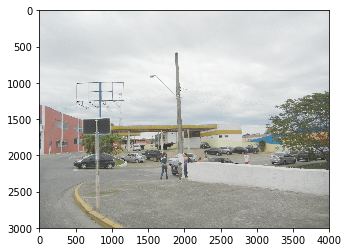

In [3]:
plt.imshow(arr)

<h2> 2.2 Mapping to an ML problem </h2>

<h3> 2.2.1 Type of Machine Leaning Problem </h3>

<p> It is a binary classification problem, for a given image need to predict if it is fake or not. </p>

<h3> 2.2.2 Performance Metrics </h3>

Metrics:
- Binary confusion matrix
- Log loss

<h1>3. Exploratory Data Analysis </h1>

<h2> 3.1. Number of images </h2>

In [ ]:
print('Number of fake images = {}'.format((len(os.listdir('dataset-dist/phase-01/training/fake/'))-1)/2)) # the folder contains both fake image and its mask
print('Number of pristine images = {}'.format((len(os.listdir('dataset-dist/phase-01/training/pristine/')))))

<h2> 3.2. Image shape </h2>

In [10]:
fake_aug_path = 'augmented_data/images/'
fake_path = 'dataset-dist/phase-01/training/fake/'
mask_path = 'dataset-dist/phase-01/training/masks/'
pristine_path = 'dataset-dist/phase-01/training/pristine/'
fake_filter = 'dataset-dist/phase-01/training/fake_filter/'
fake_copy = 'dataset-dist/phase-01/training/fake_aug/'

In [11]:
fake_aug = os.listdir(fake_aug_path)

In [12]:
fakes = os.listdir(fake_path)[1:]
masks = os.listdir(mask_path)
pristines = os.listdir(pristine_path)

In [13]:
fakes[:10] # mask followed by image

['010543abfbd0db1e9aa1b24604336e0c.mask.png',
 '010543abfbd0db1e9aa1b24604336e0c.png',
 '022354380a1a17ff49226c9eae21a11f.mask.png',
 '022354380a1a17ff49226c9eae21a11f.png',
 '0294345b3b2324b195cb3b30e91d7678.mask.png',
 '0294345b3b2324b195cb3b30e91d7678.png',
 '0363353570f16ff0a73aa0a03a7795b8.mask.png',
 '0363353570f16ff0a73aa0a03a7795b8.png',
 '0830004e471e511458600f0763ce19f3.mask.png',
 '0830004e471e511458600f0763ce19f3.png']

In [14]:
pristines[:10]

['0001d52e2fd94f30c2bca0449763a752.png',
 '000bc3906100ede4b1374cea075adedb.png',
 '002e23c036a05de656242f5ce6ab2e15.png',
 '003f2d6e572e2587ffa809f78ff4a5c4.png',
 '00d56bffe2d757a4e4625cc2d0bd0de9.png',
 '00dd93f9e4af553929e54e66c2a3186e.png',
 '00dffa8cb9db22527454bfa3c03b484b.png',
 '00e079b66d9e9f99892bbb81d9d6cd57.png',
 '00e3659be9c1fec47c739f79252840e3.png',
 '00ec0ffe0cd029ad4551680484a007d7.png']

In [15]:
# segregate masks from images
if not os.path.isdir(fake_path+'masks/'):
    os.mkdir(fake_path+'masks/')
    for fake in fakes:
        if len(fake.split('.'))==3:
            shutil.move(fake_path+fake, fake_path+'masks/')
else:
    print('Segregated already')

<h2> 3.2. Image shape fake images</h2>

In [32]:
fakes = os.listdir(fake_path)[1:-1]

In [26]:
fake_shapes=[]
for fake in fakes:
    fake_shapes.append(imread(fake_path+fake).shape)

In [27]:
for i in range(20):
    print(str(i) +'\t'+ str(fake_shapes[i]) +'\t'+fakes[i])

0	(1536, 2048, 4)	010543abfbd0db1e9aa1b24604336e0c.png
1	(768, 1024, 3)	022354380a1a17ff49226c9eae21a11f.png
2	(600, 800, 4)	0294345b3b2324b195cb3b30e91d7678.png
3	(765, 1024, 3)	0363353570f16ff0a73aa0a03a7795b8.png
4	(768, 1024, 3)	0830004e471e511458600f0763ce19f3.png
5	(768, 1024, 3)	08829849d0b1c71e437961e841e0c81f.png
6	(2736, 3648, 3)	0908dafde12041540b70d688315df6e9.png
7	(2736, 3648, 3)	092b43f88eab0ae3ecc0eb0ccbe37c82.png
8	(768, 1024, 3)	12362143f7e114beeb9d22dc59450f5a.png
9	(768, 1024, 3)	14548214e97adf237ee3bac90809baf6.png
10	(1536, 2048, 4)	152681a0017a5fded699c43cd6df97d1.png
11	(1536, 2048, 3)	17030938cc2cb314cb87552dcc9516a4.png
12	(768, 1024, 4)	1848de26a06a7831457609429c92e2e7.png
13	(1200, 1800, 4)	1990a2ed067b8c537d8fe36d1ab4a7f2.png
14	(1536, 2048, 4)	207763f02c2c5881c898386782da1728.png
15	(768, 1024, 3)	2170480823e668068b78bce75afe07a1.png
16	(4288, 3216, 3)	229f447c1a26a74005b3f058201bde3f.png
17	(768, 1024, 3)	2377136d0e2ec5c8aa15293c78ffa3d7.png
18	(2592, 193

Some fake images have 4 channels

In [36]:
for fake in fakes:
    if imread(fake_path+fake).shape[2]>4:
        print('5 channels in image ' + fake)

In [32]:
for fake in fakes:
    if imread(fake_path+fake).shape[2]<3:
        print('Less than 3 channels in image ' + fake)

In [33]:
for fake in fakes:
    if len(imread(fake_path+fake).shape)<=2:
        print(fake)

All images have 4 or 3 channels

In [37]:
four_channel_fakes=[]
for fake in fakes:
    if imread(fake_path+fake).shape[2]==4:
        four_channel_fakes.append(fake)
        
three_channel_fakes = [f for f in fakes if f not in four_channel_fakes]

In [ ]:
len(four_channel_fakes)

In [36]:
len(three_channel_fakes)

386

In [37]:
heights=[]
widths=[]

for fake in fakes:
    img=imread(fake_path+fake)
    heights.append(img.shape[0])
    widths.append(img.shape[1])

In [38]:
print('minimum height = {}'.format(min(heights)))
print('maximum height = {}'.format(max(heights)))

print('minimum width = {}'.format(min(widths)))
print('maximum width = {}'.format(max(widths)))

minimum height = 480
maximum height = 4288
minimum width = 640
maximum width = 4320


<h2> 3.3. Image shape masks</h2>

In [25]:
mask_path = fake_path + 'masks/'

In [26]:
masks = os.listdir(mask_path)

In [41]:
mask_shapes=[]
for mask in masks:
    mask_shapes.append(imread(mask_path+mask).shape)

C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')
C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')
C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


In [42]:
for i in range(20):
    print(str(i) +'\t'+ str(mask_shapes[i]) +'\t'+masks[i])

0	(1536, 2048, 4)	010543abfbd0db1e9aa1b24604336e0c.mask.png
1	(768, 1024)	022354380a1a17ff49226c9eae21a11f.mask.png
2	(600, 800, 4)	0294345b3b2324b195cb3b30e91d7678.mask.png
3	(765, 1024)	0363353570f16ff0a73aa0a03a7795b8.mask.png
4	(768, 1024)	0830004e471e511458600f0763ce19f3.mask.png
5	(768, 1024)	08829849d0b1c71e437961e841e0c81f.mask.png
6	(2736, 3648, 3)	0908dafde12041540b70d688315df6e9.mask.png
7	(2736, 3648, 3)	092b43f88eab0ae3ecc0eb0ccbe37c82.mask.png
8	(768, 1024)	12362143f7e114beeb9d22dc59450f5a.mask.png
9	(768, 1024)	14548214e97adf237ee3bac90809baf6.mask.png
10	(1536, 2048, 4)	152681a0017a5fded699c43cd6df97d1.mask.png
11	(1536, 2048, 4)	17030938cc2cb314cb87552dcc9516a4.mask.png
12	(768, 1024, 4)	1848de26a06a7831457609429c92e2e7.mask.png
13	(1200, 1800, 4)	1990a2ed067b8c537d8fe36d1ab4a7f2.mask.png
14	(1536, 2048, 4)	207763f02c2c5881c898386782da1728.mask.png
15	(768, 1024)	2170480823e668068b78bce75afe07a1.mask.png
16	(4288, 3216, 3)	229f447c1a26a74005b3f058201bde3f.mask.png
17	(

In [43]:
for mask in masks:
    img=imread(mask_path+mask)
    if len(img.shape)>2 and img.shape[2]>4:
        print('More than 4 channels in image ' + mask)

C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')
C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')
C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


In [44]:
for mask in masks:
    img=imread(mask_path+mask)
    if len(img.shape)>2 and img.shape[2]<3:
        print('Less than 3 channels in image ' + mask)

C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')
C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')
C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


In [ ]:
one_channel_masks=[]
for mask in masks:
    if len(imread(mask_path+mask).shape)==2:
        one_channel_masks.append(mask)

In [ ]:
three_channel_masks=[]
for mask in masks:
    img=imread(mask_path+mask)
    if len(img.shape)==3 and img.shape[2]==3:
        three_channel_masks.append(mask)

four_channel_masks=[m for m in masks if ((m not in one_channel_masks) and (m not in three_channel_masks))]

In [47]:
len(three_channel_masks)

65

In [48]:
len(four_channel_masks)

55

In [49]:
print(str(len(one_channel_masks))+' masks have only one channel i.e. grayscale')

330 masks have only one channel i.e. grayscale


All masks have 1, 3 or 4 channels

In [50]:
heights=[]
widths=[]

for mask in masks:
    img=imread(mask_path+mask)
    heights.append(img.shape[0])
    widths.append(img.shape[1])

print('minimum height = {}'.format(min(heights)))
print('maximum height = {}'.format(max(heights)))

print('minimum width = {}'.format(min(widths)))
print('maximum width = {}'.format(max(widths)))

C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')
C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')
C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


minimum height = 480
maximum height = 4288
minimum width = 640
maximum width = 4320


In [51]:
i=0
for mask, fake in tqdm_notebook(zip(masks, fakes)):
    mask_img=imread(mask_path+mask)
    fake_img=imread(fake_path+fake)
    if mask_img.shape[:2]!=fake_img.shape[:2]:
        i+=1
        print(str(mask_img.shape)+' '+str(fake_img.shape))

(598, 848, 3) (768, 1024, 3)
(598, 848, 3) (768, 1024, 3)
(2304, 3072, 4) (1536, 2048, 3)
(598, 848, 3) (768, 1024, 3)
(598, 848, 3) (768, 1024, 3)
(598, 848, 3) (768, 1024, 3)


C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


(598, 848, 3) (768, 1024, 3)
(598, 848, 3) (768, 1024, 3)


C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')
C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\PIL\Image.py:918: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


<h2> 3.3. Image shape pristines</h2>

In [4]:
pristine_shapes=[]
for pristine in pristines:
    pristine_shapes.append(imread(pristine_path+pristine).shape)

In [5]:
for i in range(20):
    ind=np.random.randint(0, len(pristine_shapes))
    print(str(ind) +'\t'+ str(pristine_shapes[ind]) +'\t'+pristines[ind])

133	(575, 1024, 3)	0cd6bd200bc4c3d29049698747f68fbb.png
185	(768, 1024, 3)	0ed24a267d71f3c23582d481c42d93f4.png
1001	(768, 1024, 3)	6f2bbb82168bac49bb0a9fd8a18b50be.png
50	(768, 1024, 3)	06a16145aee6965f3008ce149c119bf6.png
44	(768, 1024, 3)	05d0476ae1a480e1a79e7cfae6ab3a5d.png
993	(768, 1024, 3)	6ea15b5fb8f8090dd060b520a974599c.png
672	(768, 1024, 3)	4c68929265e566038b02668c57c48940.png
875	(575, 1024, 3)	6a5a7b324744227f828329a29744ff2a.png
289	(768, 1024, 3)	1d18a75d0da1c987bb884a181eead4b4.png
138	(768, 1024, 3)	0ce970b2308dc4b4923479605fff05ad.png
849	(575, 1024, 3)	5f2c3de190f1e231fbb68d64eae7badc.png
319	(768, 1024, 3)	1ef07bc2a8c8feecf5e27c1b72746a89.png
120	(768, 1024, 3)	0c571459fc9efdcf53d2bfb202a88744.png
1005	(768, 1024, 4)	6f5c74d3e536815751c5706f564b9800.png
126	(768, 1024, 3)	0c877a349fb3ec64aac21974756cfb31.png
529	(768, 1024, 3)	3c0045d491e0b59c5727c5d59feb1064.png
633	(768, 1024, 3)	4a803c2402240d2ede6810e9aacb38b3.png
62	(768, 1024, 3)	07af4ffd4a3e7a37903b9a22affccf

In [6]:
three_channel_pristines=[]

for pristine in pristines:
    img=imread(pristine_path+pristine)
    if len(img.shape)==3 and img.shape[2]==3:
        three_channel_pristines.append(pristine)

In [7]:
one_channel_pristines=[]

for pristine in pristines:
    img=imread(pristine_path+pristine)
    if len(img.shape)<3:
        one_channel_pristines.append(pristine)
    
four_channel_pristines=[p for p in pristines if (p not in one_channel_pristines) and (p not in three_channel_pristines)]

In [8]:
len(one_channel_pristines)

3

In [10]:
for pristine in one_channel_pristines:
    img=imread(pristine_path+pristine)
    print(img.shape)

(768, 1024)
(768, 1024)
(768, 1024)


In [11]:
len(three_channel_pristines)

1025

In [12]:
len(four_channel_pristines)

22

In [13]:
table={}
table['pristines']=[3, 1025, 22, 1050]
table['fakes']=[0, 386, 64, 450]
table['masks']=[330, 65, 55, 450]
pd.DataFrame(table, index=['1 channel', '3 channel', '4 channel', 'total'])

,pristines,fakes,masks
1 channel,3,0,330
3 channel,1025,386,65
4 channel,22,64,55
total,1050,450,450


In [16]:
four_channel_image = imread(pristine_path+four_channel_pristines[1])

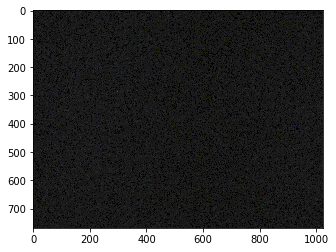

In [17]:
plt.imshow(four_channel_image)

Only use 3 channel pristines, discard 1 and 4 channel images

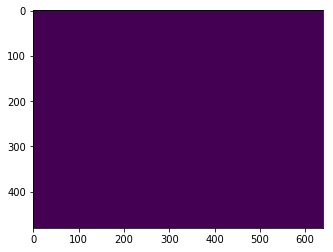

In [22]:
four_channel_image = imread(fake_path+four_channel_fakes[9])
plt.imshow(four_channel_image[:,:,3])

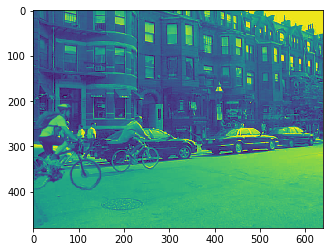

In [23]:
plt.imshow(four_channel_image[:,:,2])

Discard channel 4 of 4 channel masks. In fact the feature engineering phase requires only one channel information. The same information is duplicated across other 2 channels

In [17]:
heights=[]
widths=[]

for pristine in pristines:
    img=imread(pristine_path+pristine)
    heights.append(img.shape[0])
    widths.append(img.shape[1])

print('minimum height = {}'.format(min(heights)))
print('maximum height = {}'.format(max(heights)))

print('minimum width = {}'.format(min(widths)))
print('maximum width = {}'.format(max(widths)))

minimum height = 575
maximum height = 768
minimum width = 576
maximum width = 1024


Pickle the data

In [38]:
with open('one_channel_pristines.pickle', 'wb') as f:
    pickle.dump(one_channel_pristines, f)
    
with open('three_channel_pristines.pickle', 'wb') as f:
    pickle.dump(three_channel_pristines, f)

with open('four_channel_pristines.pickle', 'wb') as f:
    pickle.dump(four_channel_pristines, f)
    
with open('three_channel_fakes.pickle', 'wb') as f:
    pickle.dump(three_channel_fakes, f)
    
with open('four_channel_fakes.pickle', 'wb') as f:
    pickle.dump(four_channel_fakes, f)

with open('one_channel_masks.pickle', 'wb') as f:
    pickle.dump(one_channel_masks, f)
    
with open('three_channel_masks.pickle', 'wb') as f:
    pickle.dump(three_channel_masks, f)
    
with open('four_channel_masks.pickle', 'wb') as f:
    pickle.dump(four_channel_masks, f)

In [4]:
with open('one_channel_pristines.pickle', 'rb') as f:
    one_channel_pristines = pickle.load(f)
    
with open('three_channel_pristines.pickle', 'rb') as f:
    three_channel_pristines = pickle.load(f)

with open('four_channel_pristines.pickle', 'rb') as f:
    four_channel_pristines=pickle.load(f)
    
with open('three_channel_fakes.pickle', 'rb') as f:
    three_channel_fakes=pickle.load(f)
    
with open('four_channel_fakes.pickle', 'rb') as f:
    four_channel_fakes=pickle.load(f)

with open('one_channel_masks.pickle', 'rb') as f:
    one_channel_masks=pickle.load(f)
    
with open('three_channel_masks.pickle', 'rb') as f:
    three_channel_masks=pickle.load(f)
    
with open('four_channel_masks.pickle', 'rb') as f:
    four_channel_masks=pickle.load(f)

Converting the 22 4 channel pristine images to 3 channel.

In [ ]:
from PIL import Image
for four_channel_pristine in four_channel_pristines:
    im = Image.open(pristine_path+four_channel_pristine)
    im.convert("RGB").save(pristine_path+four_channel_pristine)

In [83]:
for four_channel_pristine in four_channel_pristines:
    img=imread(pristine_path+four_channel_pristine)
    print(img.shape)

(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 576, 3)
(768, 1024, 3)
(681, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(681, 1024, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 576, 3)
(768, 1024, 3)
(768, 1024, 3)
(768, 576, 3)
(768, 1024, 3)


After all data cleaning we have :
- 1047 pristine images (3 channels)
- 450 fake images (3 channels)
- 450 masks (1 channel)

masks will be used to sample image patches for creation of train and cv data (label = fake) to be fed into CNN. This ensures that CNN learns boundaries created due to forgery operations because of change in statistics of underlying image at these boundaries

<h2> 4. Dataset preparation </h2>

<h3> 4.1. Concatenate pristine and fake images </h3>

Converting the 4 channel images to 3 channel.

In [30]:
pristines_final=[]
for pristine in pristines:
    img=imread(pristine_path+pristine)
    if len(img.shape)<3:
        continue
    if img.shape[2]==4:
        continue
    pristines_final.append(pristine)

In [31]:
len(pristines_final)

1047

In [6]:
fake_images=[]
fakes_final=[]
for fake in fakes:
    img=imread(fake_path+fake)
    try:
        fake_images.append(img[:,:,:3])
        fakes_final.append(fake)
    except IndexError:
        print(f'image {fake} has only 1 channel')

In [ ]:
image_names=[]
for i in range(0, len(pristines_final)):
    image_names.append(pristines_final[i])
for i in range(0, len(fake_images)):
    image_names.append(fakes_final[i])

In [35]:
len(image_names)

1497


<h3> 4.2. Train test split </h3>

We have 1047 pristine images and 450 fake images. Since no timestamp has been given we resort to random splitting.<br>
80% train, 20% test

In [37]:
labels=[0]*1047+[1]*450

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(image_names, labels, test_size=0.2, stratify=labels)

In [10]:
np.save('x_test',x_test)
np.save('y_test',y_test)

<h3> 4.3. Feature engineering on train set </h3>

As suggested in https://ieeexplore.ieee.org/abstract/document/7823911 we will extract image patches from training images both from pristine and fake images. First we will use masks to sample fake images at boundaries. These will be labeled as fake images.

In [60]:
x_train_images=[]
for x in x_train:
    try:
        img=imread(pristine_path+x)
    except FileNotFoundError:
        img=imread(fake_path+x)
    
    x_train_images.append(img)

In [61]:
heights=[]
widths=[]

for image in x_train_images:
    heights.append(image.shape[0])
    widths.append(image.shape[1])

In [62]:
max(heights)

4288

In [63]:
min(heights)

480

In [64]:
max(widths)

4320

In [65]:
min(widths)

640

In [66]:
x_train_mask_names=[]
for ind, x in enumerate(x_train):
    if y_train[ind]==1:
        x_train_mask_names.append(x.split('.')[0]+'.mask.png')

In [67]:
x_train_fakes_names=[]
x_train_fake_images=[]
for ind, x in enumerate(x_train):
    if y_train[ind]==1:
        x_train_fakes_names.append(x)
        x_train_fake_images.append(x_train_images[ind])

In [68]:
x_train_pristines_names=[]
x_train_pristine_images=[]
for ind, x in enumerate(x_train):
    if y_train[ind]==0:
        x_train_pristines_names.append(x)
        x_train_pristine_images.append(x_train_images[ind])

In [70]:
x_train_masks=[]
for m in x_train_mask_names:
    
    img=imread(mask_path+m)
    
    if len(img.shape)>2:
        img=img[:,:,0]
        
    x_train_masks.append(img)

In [82]:
x_train_fake_images[20].shape

(1200, 1600, 3)

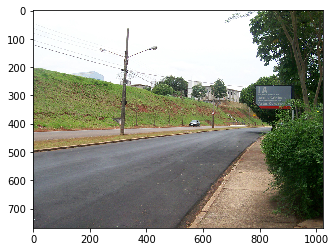

In [83]:
plt.imshow(x_train_fake_images[0][:,:,:3])

In [73]:
heights=[]
widths=[]

for image in x_train_masks:
    heights.append(image.shape[0])
    widths.append(image.shape[1])

In [74]:
max(heights)

4288

In [75]:
min(heights)

480

In [76]:
max(widths)

4320

In [77]:
min(widths)

640

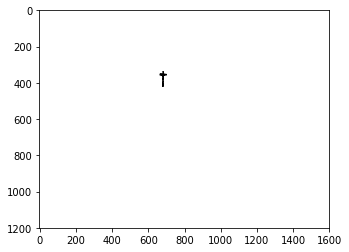

In [78]:
plt.imshow(x_train_masks[30], cmap='gray')

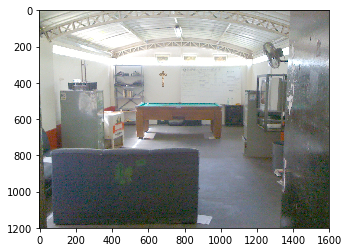

In [79]:
plt.imshow(x_train_fake_images[30])

In [84]:
# Convert grayscale images to binary
binaries=[]

for grayscale in x_train_masks:
    blur = cv2.GaussianBlur(grayscale,(5,5),0)
    ret,th = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    binaries.append(th)

In [86]:
~binaries[30]

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

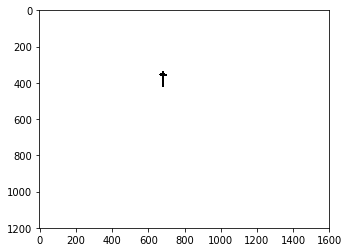

In [88]:
plt.imshow(binaries[30], cmap='gray')

In [89]:
mask_pixels = [np.count_nonzero(~binaries[i]) for i in range(len(binaries))]

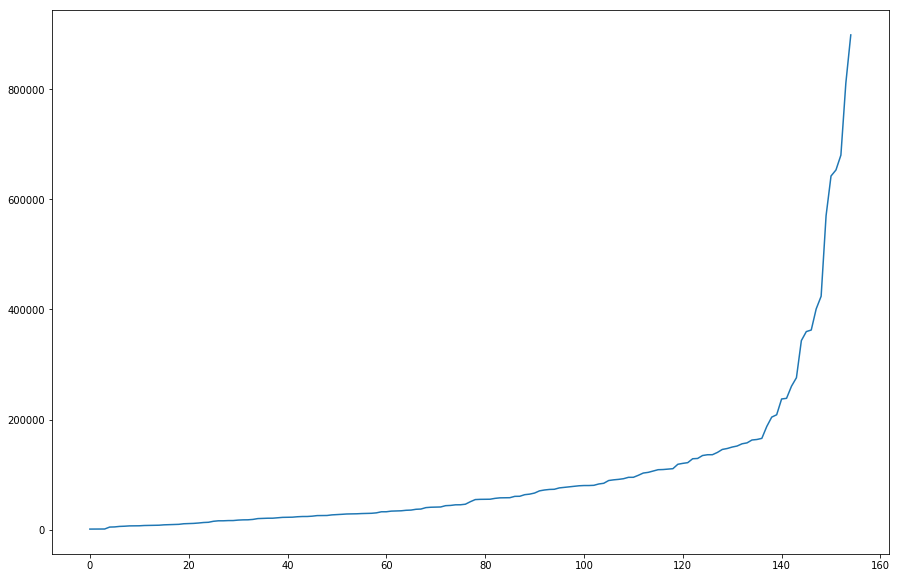

In [90]:
rcParams['figure.figsize']=15,10
plt.plot(sorted(mask_pixels))

We must capture information from every image. We use patch size of 64 * 64 and ensuring minimum 40% contribution from forged area and authentic area.<br>This ensures that more than 99% of masks are covered including discriminative boundary at the same time

In [11]:
def count_255(mask):
    i=0
    for row in range(mask.shape[0]):
        for col in range(mask.shape[1]):
            if mask[row,col]==255:
                i+=1
    return i

In [12]:
def sample_fake(img, mask):
    kernel_size=64
    stride=32
    
    samples=[]
    
    for y_start in range(0, img.shape[0]-kernel_size+1, stride):
        for x_start in range(0, img.shape[1]-kernel_size+1, stride):
            
            c_255=count_255(mask[y_start:y_start+kernel_size, x_start:x_start+kernel_size])
            
            if (c_255>1600) and (kernel_size*kernel_size-c_255>1600):
                samples.append(img[y_start:y_start+kernel_size, x_start:x_start+kernel_size, :3])    
        
    return samples

In [13]:
sample=sample_fake(x_train_fake_images[20], x_train_masks[20])

In [14]:
len(sample)

13

In [103]:
x_train_fake_images[30].shape

(1200, 1600, 3)

In [104]:
x_train_masks[30].shape

(1200, 1600)

In [98]:
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)

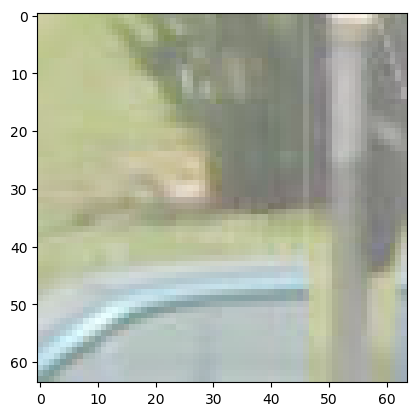

In [105]:
plt.imshow(sample[0])

In [128]:
len(x_train_fake_images)

155

In [2]:
from tqdm import tqdm_notebook as tqdm

In [3]:
with open('x_train_fake_images.pickle', 'rb') as f:
    x_train_fake_images=pickle.load(f)
with open('x_train_masks.pickle', 'rb') as f:
    x_train_masks=pickle.load(f)

In [15]:
samples_fake=[]
i=0
for fake, mask in tqdm(zip(x_train_fake_images, x_train_masks)):
    image_samples=sample_fake(fake, mask)
    for sample in image_samples:
        samples_fake.append(sample)
        i+=1

In [16]:
np.save('samples_fake_grayscale.npy', samples_fake)

In [17]:
def sample_fake(img, mask):
    kernel_size = 64
    stride = 8
    threshold=1024

    samples = []

    for y_start in range(0, img.shape[0] - kernel_size + 1, stride):
        for x_start in range(0, img.shape[1] - kernel_size + 1, stride):

            c_255 = count_255(mask[y_start:y_start + kernel_size, x_start:x_start + kernel_size])

            if (c_255 > threshold) and (kernel_size * kernel_size - c_255 > threshold):
                samples.append(img[y_start:y_start + kernel_size, x_start:x_start + kernel_size, :3])

    return samples

In [18]:
samples_fake=[]
i=0
for fake, mask in zip(x_train_fake_images, x_train_masks):
    image_samples=sample_fake(fake, mask)
    for sample in image_samples:
        samples_fake.append(sample)
        i+=1

In [19]:
np.save('fake_samples_binary.npy', samples_fake)

Using kernel size of 64 and stride of 32 produces about 4000 fake samples. Decreasing the stride generates a larger dataset of fake images. We try both stride=32 on grayscale images and stride=8 on binary images.

In [4]:
samples_fake_grayscale = np.load('samples_fake_grayscale.npy')
samples_fake_binary = np.load('fake_samples_binary.npy')

In [5]:
samples_fake_grayscale.shape

(2269, 64, 64, 3)

In [6]:
fake_samples_grayscale = samples_fake_grayscale.shape[0]
fake_samples_binary = samples_fake_binary.shape[0]

In [7]:
print(f'we have {fake_samples_grayscale} fake samples each of shape 64 * 64 using grayscale masks')
print(f'we have {fake_samples_binary} fake samples each of shape 64 * 64 using binary masks')

we have 2269 fake samples each of shape 64 * 64 using grayscale masks
we have 93151 fake samples each of shape 64 * 64 using binary masks


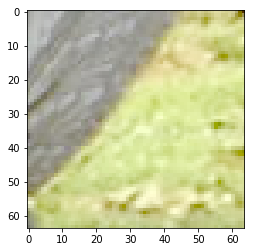

In [8]:
plt.imshow(samples_fake_grayscale[500])

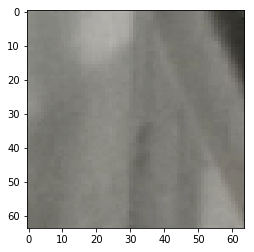

In [9]:
plt.imshow(samples_fake_binary[10000])

Now to create negative samples we randomly sample 64 * 64 patches from authentic images

In [143]:
def sample_random(img, num_samples, stride=8):
    kernel_size=64
    
    x_start=0
    y_start=0
    samples=[]
    
    for y_start in range(0, img.shape[0] - kernel_size + 1, stride):
        for x_start in range(0, img.shape[1] - kernel_size + 1, stride):

            #c_255 = count_255(mask[y_start:y_start + kernel_size, x_start:x_start + kernel_size])

            #if (c_255 > threshold) and (kernel_size * kernel_size - c_255 > threshold):
            samples.append(img[y_start:y_start + kernel_size, x_start:x_start + kernel_size, :3])

    
    indices=np.random.randint(0, len(samples), min(len(samples), num_samples))
    
    sampled=[]
    for i in indices:
        sampled.append(samples[i])
    
    return sampled

In [118]:
# some images have all pixels=0 those images have been manually deleted

In [38]:
len(x_train_pristine_images)

1047


In [130]:
len(x_train_fake_images)

155

In [39]:
4802/1047

4.586437440305635

In [40]:
5*1047

5235

5 samples per pristine image

In [ ]:
samples_pristine_grayscale=np.ndarray(shape=(5235, 64, 64, 3), dtype=np.dtype('uint8'))

i=0
for pristine_img in x_train_pristine_images:
    
    samples=sample_random(pristine_img, 5, stride=32)
    for sample in samples:
        samples_pristine_grayscale[i, :, :, :]=sample
        i+=1

In [41]:
len(x_train_pristine_images)

1047


In [42]:
175609/1047

167.72588347659982

In [44]:
168*1047

175896

168 samples per pristine image

In [ ]:
samples_pristine_binary=np.ndarray(shape=(175896, 64, 64, 3), dtype=np.dtype('uint8'))

i=0
for pristine_img in tqdm(x_train_pristine_images):
    
    samples=sample_random(pristine_img, 168)
    for j, sample in enumerate(samples):
        samples_pristine_binary[i, :, :, :]=sample
        i+=1

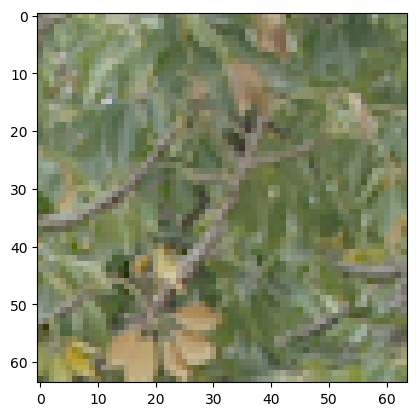

In [146]:
plt.imshow(samples_pristine_grayscale[2500])

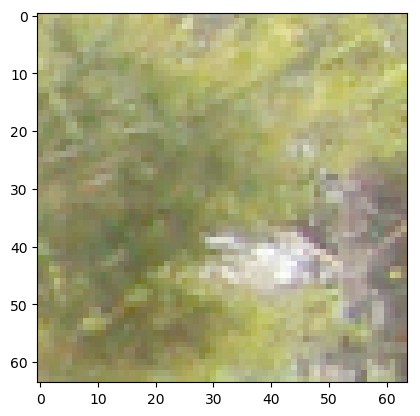

In [147]:
plt.imshow(samples_pristine_binary[2500])

In [11]:
samples_pristine_grayscale = np.load('samples_pristine_grayscale.npy')
samples_pristine_binary = np.load('samples_pristine_binary.npy')

In [46]:
print(f'number of fake samples in\n1. binary mask extraction using stride of 8 = {len(samples_fake_binary)}\n\
2. in grayscale mask extraction using stride of 32 = {len(samples_fake_grayscale)}\n\n\
number of pristine samples in\n1. binary mask extraction using stride of 8 = {len(samples_pristine_binary)}\n\
2. in grayscale mask extraction using stride of 32 = {len(samples_pristine_grayscale)}')

number of fake samples in
1. binary mask extraction using stride of 8 = 93151
2. in grayscale mask extraction using stride of 32 = 2269

number of pristine samples in
1. binary mask extraction using stride of 8 = 175896
2. in grayscale mask extraction using stride of 32 = 5235


In [13]:
train_labels_binary=[0]*len(samples_pristine_binary)+[1]*len(samples_fake_binary)
train_labels_grayscale=[0]*len(samples_pristine_grayscale)+[1]*len(samples_fake_grayscale)

In [148]:
np.save('samples_pristine_grayscale.npy', samples_pristine_grayscale)
np.save('samples_pristine_binary.npy', samples_pristine_binary)

In [109]:
with open('x_train_fake_images.pickle', 'wb') as f:
    pickle.dump(x_train_fake_images, f)

with open('x_train_images.pickle', 'wb') as f:
    pickle.dump(x_train_images, f)
        
with open('x_train_pristine_images.pickle', 'wb') as f:
    pickle.dump(x_train_pristine_images, f)

In [112]:
len(x_train_masks)

155

In [111]:
#with open('x_train_masks.pickle', 'wb') as f:
#    pickle.dump(x_train_masks, f)

In [14]:
with open('train_labels_binary.pickle', 'wb') as f:
    pickle.dump(train_labels_binary, f)
    
with open('train_labels_grayscale.pickle', 'wb') as f:
    pickle.dump(train_labels_grayscale, f)

In [15]:
with open('x_train_masks.pickle', 'rb') as f:
        x_train_masks= pickle.load(f)

In [18]:
with open('x_train_fake_images.pickle', 'rb') as f:
    x_train_fakes_images=pickle.load(f)

In [19]:
with open('x_train_pristine_images.pickle', 'rb') as f:
    x_train_pristine_images=pickle.load(f)

In [47]:
samples_pristine_grayscale.shape

(5235, 64, 64, 3)


In [24]:
samples_fake_grayscale.shape

(2269, 64, 64, 3)

In [48]:
len(train_labels_grayscale)

7504


In [49]:
samples_pristine_binary.shape

(175896, 64, 64, 3)


In [28]:
samples_fake_binary.shape

(93151, 64, 64, 3)

In [50]:
len(train_labels_binary)

269047


In [30]:
# Concatenate authentic and fake image samples along axis=0 to generate train set for grayscale sampled images
train_data_grayscale = np.concatenate((samples_pristine_grayscale, samples_fake_grayscale), axis=0)

In [44]:
x_train, x_cv, y_train, y_cv = train_test_split(train_data_grayscale, train_labels_grayscale, test_size=0.3, stratify = train_labels_grayscale)

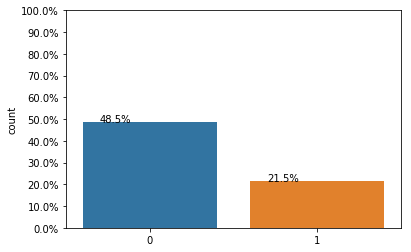

In [45]:
total = len(train_labels_grayscale)*1.
ax=sns.countplot(y_train)
for p in ax.patches:
    ax.annotate('{:.1f}%'.format(100*p.get_height()/total), (p.get_x()+0.1, p.get_height()+5))

#put 11 ticks (therefore 10 steps), from 0 to the total number of rows in the dataframe
ax.yaxis.set_ticks(np.linspace(0, total, 11))

#adjust the ticklabel to the desired format, without changing the position of the ticks. 
ax.set_yticklabels(map('{:.1f}%'.format, 100*ax.yaxis.get_majorticklocs()/total))
plt.show()

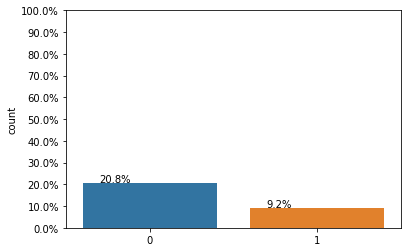

In [46]:
total = len(train_labels_grayscale)*1.
ax=sns.countplot(y_cv)
for p in ax.patches:
    ax.annotate('{:.1f}%'.format(100*p.get_height()/total), (p.get_x()+0.1, p.get_height()+5))

#put 11 ticks (therefore 10 steps), from 0 to the total number of rows in the dataframe
ax.yaxis.set_ticks(np.linspace(0, total, 11))

#adjust the ticklabel to the desired format, without changing the position of the ticks. 
ax.set_yticklabels(map('{:.1f}%'.format, 100*ax.yaxis.get_majorticklocs()/total))
plt.show()

In [47]:
if not os.path.isdir('train_data'):
    os.mkdir('train_data')
    
    np.save('train_data/x_train.npy', x_train)
    np.save('train_data/x_cv.npy', x_cv)
    
    np.save('train_data/y_train.npy', y_train)
    np.save('train_data/y_cv.npy', y_cv)
else:
    print('train data exists')

In [48]:
# Concatenate authentic and fake image samples along axis=0 to generate train set for binary sampled images
train_data_binary = np.concatenate((samples_pristine_binary, samples_fake_binary), axis=0)

In [64]:
x_train, x_cv, y_train, y_cv = train_test_split(train_data_binary, train_labels_binary, test_size=0.3, stratify = train_labels_binary)

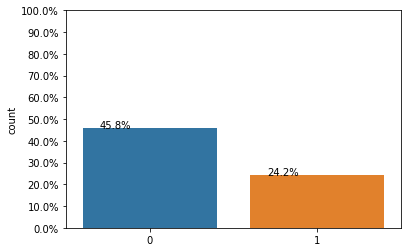

In [50]:
total = len(train_labels_binary)*1.
ax=sns.countplot(y_train)
for p in ax.patches:
    ax.annotate('{:.1f}%'.format(100*p.get_height()/total), (p.get_x()+0.1, p.get_height()+5))

#put 11 ticks (therefore 10 steps), from 0 to the total number of rows in the dataframe
ax.yaxis.set_ticks(np.linspace(0, total, 11))

#adjust the ticklabel to the desired format, without changing the position of the ticks. 
ax.set_yticklabels(map('{:.1f}%'.format, 100*ax.yaxis.get_majorticklocs()/total))
plt.show()

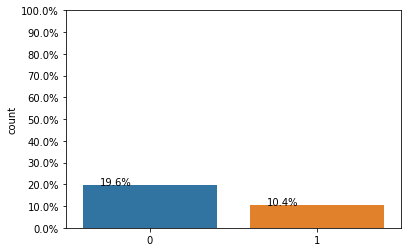

In [51]:
total = len(train_labels_binary)*1.
ax=sns.countplot(y_cv)
for p in ax.patches:
    ax.annotate('{:.1f}%'.format(100*p.get_height()/total), (p.get_x()+0.1, p.get_height()+5))

#put 11 ticks (therefore 10 steps), from 0 to the total number of rows in the dataframe
ax.yaxis.set_ticks(np.linspace(0, total, 11))

#adjust the ticklabel to the desired format, without changing the position of the ticks. 
ax.set_yticklabels(map('{:.1f}%'.format, 100*ax.yaxis.get_majorticklocs()/total))
plt.show()

In [52]:
if not os.path.isdir('train_data2'):
    os.mkdir('train_data2')
    
    np.save('train_data2/x_train.npy', x_train)
    np.save('train_data2/x_cv.npy', x_cv)
    
    np.save('train_data2/y_train.npy', y_train)
    np.save('train_data2/y_cv.npy', y_cv)
else:
    print('train data exists')

<h2> 5. Deep learning models </h2>

In [3]:
# This function plots the confusion matrices given y_i, y_i_hat.
def plot_confusion_matrix(test_y, predict_y):
    C = confusion_matrix(test_y, predict_y)
    # C = 9,9 matrix, each cell (i,j) represents number of points of class i are predicted class j
    
    A =(((C.T)/(C.sum(axis=1))).T)
    #divid each element of the confusion matrix with the sum of elements in that column
    
    # C = [[1, 2],
    #     [3, 4]]
    # C.T = [[1, 3],
    #        [2, 4]]
    # C.sum(axis = 1)  axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =1) = [[3, 7]]
    # ((C.T)/(C.sum(axis=1))) = [[1/3, 3/7]
    #                           [2/3, 4/7]]

    # ((C.T)/(C.sum(axis=1))).T = [[1/3, 2/3]
    #                           [3/7, 4/7]]
    # sum of row elements = 1
    
    B =(C/C.sum(axis=0))
    #divid each element of the confusion matrix with the sum of elements in that row
    # C = [[1, 2],
    #     [3, 4]]
    # C.sum(axis = 0)  axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =0) = [[4, 6]]
    # (C/C.sum(axis=0)) = [[1/4, 2/6],
    #                      [3/4, 4/6]] 
    plt.figure(figsize=(20,4))
    
    labels = [0,1]
    # representing A in heatmap format
    cmap=sns.light_palette("blue")
    
    plt.subplot(1, 3, 2)
    sns.heatmap(B, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Precision matrix")
    
    plt.subplot(1, 3, 3)
    # representing B in heatmap format
    sns.heatmap(A, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Recall matrix")
    
    plt.show()

<h3> 5.1. Random model (worst case performance)</h3>

Log loss on Test Data using Random Model 0.8836496298967451
Accuracy on Test Data using Random Model 0.4999752585481716


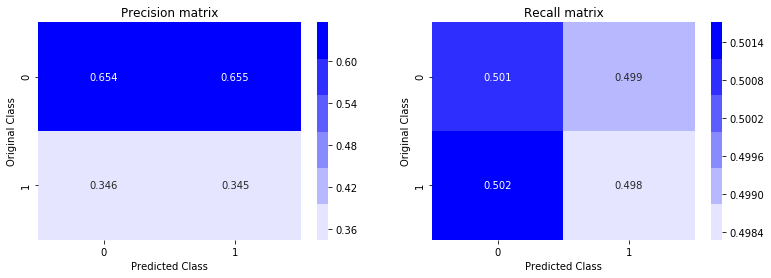

In [54]:
test_len=len(y_cv)
predicted_y_prob = np.zeros((test_len,2))
for i in range(test_len):
    rand_probs = np.random.rand(1,2)
    predicted_y_prob[i] = ((rand_probs/sum(sum(rand_probs)))[0])
    
print("Log loss on Test Data using Random Model",log_loss(y_cv, predicted_y_prob, eps=1e-15))
predicted_y =np.argmax(predicted_y_prob, axis=1)
print("Accuracy on Test Data using Random Model",accuracy_score(y_cv, predicted_y))

plot_confusion_matrix(y_cv, predicted_y)

Our CNN model must give log loss less than 0.88, accuracy more than 49.9%

<h3> 5.2. CNN architecture</h3>

In [4]:
import keras
from keras.models import load_model, Sequential
from keras.layers import Input,Dense, Dropout, Activation, Flatten,Conv2D, MaxPooling2D,BatchNormalization
from keras.applications.resnet50 import ResNet50
from keras.applications.vgg16 import VGG16
from keras import optimizers
from keras.models import Model, load_model
from keras.layers import Input, BatchNormalization, Activation, Dense, Dropout
from keras.layers.core import Lambda, RepeatVector, Reshape
from keras.layers.convolutional import Conv2D, Conv2DTranspose
from keras.layers.pooling import MaxPooling2D, GlobalMaxPool2D
from keras.layers.merge import concatenate, add
from keras.optimizers import Adam,SGD
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from skimage.transform import resize

C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [51]:
x_test=np.load('x_test.npy')

y_test=np.load('y_test.npy')

#### 5.2.1 VGG16

In [3]:
vgg_model=keras.applications.VGG16(weights='imagenet', include_top=False, input_shape=(64,64,3))

model_aug=Sequential()
model_aug.add(vgg_model)

top_model=Sequential()
top_model.add(Flatten(input_shape=(2, 2, 512)))
model_aug.add(Dropout(0.2))
top_model.add(Dense(64, activation='relu'))
top_model.add(Dense(1, activation='sigmoid'))

model_aug.add(top_model)

for layer in model_aug.layers[0].layers[:17]:
    layer.trainable=False
        
model_aug.load_weights('fine_tuned_adam_weights.h5')

In [4]:
model_aug.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 2, 2, 512)         14714688  
_________________________________________________________________
sequential_2 (Sequential)    (None, 1)                 131201    
Total params: 14,845,889
Trainable params: 2,491,009
Non-trainable params: 12,354,880
_________________________________________________________________


In [7]:
model_aug.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=1e-6), metrics=['accuracy'])

In [74]:
model_aug.evaluate(x_test, y_test, verbose=0)

[0.3567892, 0.93524]


In [26]:
y_pred = model_aug.predict_classes(x_test)

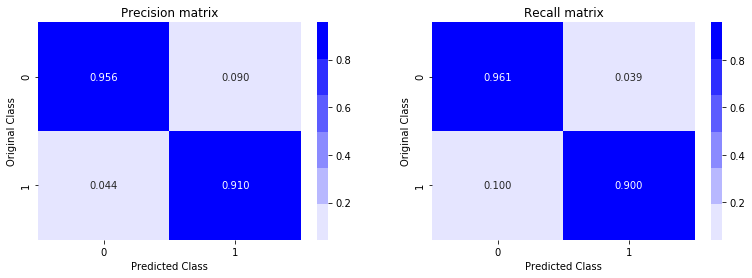

In [73]:
plot_confusion_matrix(y_test, y_pred)

#### 5.2.2 ResNet50

In [ ]:
resnet_model=ResNet50(weights='imagenet', include_top=False, input_shape=(64, 64, 3))

model_aug=Sequential()
model_aug.add(resnet_model)

top_model=Sequential()
top_model.add(Flatten(input_shape=(2, 2, 2048)))

top_model.add(Dense(64, activation='relu'))
model_aug.add(Dropout(0.2))
top_model.add(Dense(1, activation='sigmoid'))

model_aug.add(top_model)

for layer in model_aug.layers[0].layers[:171]:
    layer.trainable=False

model_aug.load_weights('fine_tuned_resnet_adam_weights.h5')

model_aug.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=1e-3), metrics=['accuracy'])

In [82]:
model_aug.evaluate(x_test, y_test, verbose=0)

[0.22367334, 0.94528]


In [20]:
y_pred = model_aug.predict_classes(x_test)

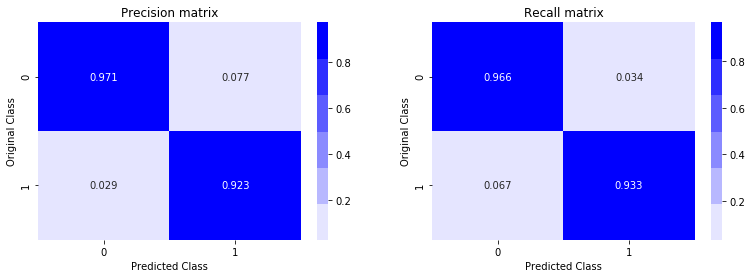

In [81]:
plot_confusion_matrix(y_test, y_pred)

In [11]:
from PIL import Image
for four_channel_mask in four_channel_masks:
    im = Image.open(mask_path+four_channel_mask)
    im.convert("RGB").save(mask_path+four_channel_mask)
    
for four_channel_fake in four_channel_fakes:
    im = Image.open(fake_path+four_channel_fake)
    im.convert("RGB").save(fake_path+four_channel_fake)

# ELA

In [7]:
from PIL import Image, ImageChops, ImageEnhance

for file in (os.listdir(fake_path)):
    filename = fake_path+"{}".format(file)
    resaved = '.resaved.jpg'
    ela = "./augmented_data/ela95/{}".format(file)
    #ela = fake_path+"{}".format(file)
    im = Image.open(filename).convert("RGB")
    im.save(resaved, 'JPEG', quality=98)
    resaved_im = Image.open(resaved)
    ela_im = ImageChops.difference(im, resaved_im)
    extrema = ela_im.getextrema()
    max_diff = max([ex[1] for ex in extrema])
    scale = 255.0/max_diff
    ela_im = ImageEnhance.Brightness(ela_im).enhance(scale)
    ela_im.save(ela)
print("DONE Converting to ELA!")

DONE Converting to ELA!


In [16]:
#for pristine images
for file in (os.listdir(pristine_path)):
    filename = pristine_path+"{}".format(file)
    resaved = '.resaved.jpg'
    ela = "./augmented_data/ela95/{}".format(file)
    #ela = fake_path+"{}".format(file)
    im = Image.open(filename).convert("RGB")
    im.save(resaved, 'JPEG', quality=98)
    resaved_im = Image.open(resaved)
    ela_im = ImageChops.difference(im, resaved_im)
    extrema = ela_im.getextrema()
    max_diff = max([ex[1] for ex in extrema])
    scale = 255.0/max_diff
    ela_im = ImageEnhance.Brightness(ela_im).enhance(scale)
    ela_im.save(ela)
print("DONE Converting to ELA!")

DONE Converting to ELA!


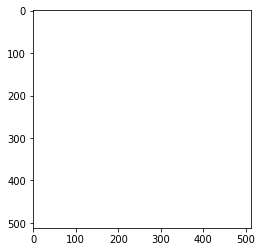

In [9]:
from PIL import Image, ImageChops, ImageEnhance
import PIL
img=Image.open('./white.png')
img=img.resize((512, 512), PIL.Image.ANTIALIAS)
plt.imshow(img)
img.save('./defaultmask.png')


In [13]:
len(pristines)

1050

In [14]:
w=3143
for pristine in pristines:
    image=cv2.imread(pristine_path+pristine)
    mask=cv2.imread('./defaultmask.png')
    img_o=Image.fromarray(image)
    mskh_o=Image.fromarray(mask)
    img_o.save('./augmented_data/images/image{}.png'.format(w))
    mskh_o.save('./augmented_data/masks/mask{}.png'.format(w))
    w=w+1
print("Done!")

Done!


# Data Augumentations

In [ ]:
from albumentations import (
PadIfNeeded,
HorizontalFlip,
VerticalFlip,
CenterCrop,
Crop,
Compose,
Transpose,
RandomRotate90,
ElasticTransform,
GridDistortion,
OpticalDistortion,
RandomSizedCrop,
OneOf,
CLAHE,
RandomBrightnessContrast,
RandomGamma
)

In [ ]:
# a bunch of functions for image augmentation
def horizontalFlip(image,mask):
    aug = HorizontalFlip(p=1)
    augmented = aug(image=image, mask=mask)
    image_h_flipped = augmented['image']
    mask_h_flipped = augmented['mask']
    return image_h_flipped,mask_h_flipped
def verticalFlip(image,mask):
    aug = VerticalFlip(p=1)
    augmented = aug(image=image, mask=mask)
    image_v_flipped = augmented['image']
    mask_v_flipped = augmented['mask']
    return image_v_flipped,mask_v_flipped

def randomRotate(image,mask):
    aug = RandomRotate90(p=1)
    augmented = aug(image=image, mask=mask)
    image_rot90 = augmented['image']
    mask_rot90 = augmented['mask']
    return image_rot90,mask_rot90
def transpose(image,mask):
    aug = Transpose(p=1)
    augmented = aug(image=image, mask=mask)
    image_transposed = augmented['image']
    mask_transposed = augmented['mask']
    return image_transposed,mask_transposed
def elasticDistortion(image,mask):
    aug = ElasticTransform(p=1, alpha=120, sigma=120 * 0.05, alpha_affine=120 *0.03)
    augmented = aug(image=image, mask=mask)
    image_elastic = augmented['image']
    mask_elastic = augmented['mask']
    return image_elastic,mask_elastic

def opticalDistortion(image,mask):
    aug = OpticalDistortion(p=1, distort_limit=2, shift_limit=0.5)
    augmented = aug(image=image, mask=mask)
    image_optical = augmented['image']
    mask_optical = augmented['mask']
    return image_optical,mask_optical

In [ ]:
import re
from PIL import Image

if not os.path.isfile('./augmented_data'):
    os.makedirs('./augmented_data/images')
    os.makedirs('./augmented_data/masks')
    
w=0
for fake in fakes:

    image=cv2.imread(fake_path+fake)
    
    mask = re.sub(".png", ".mask.png", fake)
    mask=cv2.imread(mask_path+mask)
    
    actual_image=image.copy()
    actual_mask=mask.copy()
    img_o=Image.fromarray(actual_image)
    mskh_o=Image.fromarray(actual_mask)
    img_o.save('./augmented_data/images/image{}.png'.format(w))
    mskh_o.save('./augmented_data/masks/mask{}.png'.format(w))
    
    h=horizontalFlip(image,mask)
    imgh=Image.fromarray(h[0])
    mskh=Image.fromarray(h[1])
    imgh.save('./augmented_data/images/image{}.png'.format(w+1))
    mskh.save('./augmented_data/masks/mask{}.png'.format(w+1))
    
    v=verticalFlip(image,mask)
    imgv=Image.fromarray(v[0])
    mskv=Image.fromarray(v[1])
    imgv.save('./augmented_data/images/image{}.png'.format(w+2))
    mskv.save('./augmented_data/masks/mask{}.png'.format(w+2))
    
    t=transpose(image,mask)
    imgt=Image.fromarray(t[0])
    mskt=Image.fromarray(t[1])
    imgt.save('./augmented_data/images/image{}.png'.format(w+3))
    mskt.save('./augmented_data/masks/mask{}.png'.format(w+3))
    
    r=randomRotate(image,mask)
    imgr=Image.fromarray(r[0])
    mskr=im=Image.fromarray(r[1])
    imgr.save('./augmented_data/images/image{}.png'.format(w+4))
    mskr.save('./augmented_data/masks/mask{}.png'.format(w+4))

    o=opticalDistortion(image,mask)
    imgo=Image.fromarray(o[0])
    msko=Image.fromarray(o[1])
    imgo.save('./augmented_data/images/image{}.png'.format(w+5))
    msko.save('./augmented_data/masks/mask{}.png'.format(w+5))

    e=elasticDistortion(image,mask)
    imge=Image.fromarray(e[0])
    mske=Image.fromarray(e[1])
    imge.save('./augmented_data/images/image{}.png'.format(w+6))
    mske.save('./augmented_data/masks/mask{}.png'.format(w+6))
    w=w+7
    
    

# Train Test Split

In [5]:
ela_image_files=[]
mask_files=[]
for i in range(4193):
    ela_image_path="image{}.png".format(i)
    mask_path="mask{}.png".format(i)
    ela_image_files.append(ela_image_path)
    mask_files.append(mask_path)

In [6]:
fake_train, fake_test, mask_train, mask_test = train_test_split(ela_image_files,mask_files , test_size=0.15, random_state=0)

In [7]:
fake_train, fake_cv, mask_train, mask_cv = train_test_split(fake_train,mask_train , test_size=0.15, random_state=0)

In [8]:
x_test_copy = []    
for x in fake_test:
    try:
        img=imread(fake_aug_path+x)
    except FileNotFoundError:
        img=imread(fake_copy+x)
    
    x_test_copy.append(img[:,:,:3])
    

In [13]:
y_test_images = []    
for x in mask_test:
    try:
        img=imread(mask_path+x)
    except FileNotFoundError:
        img=imread(fake_copy+x)
    
    y_test_images.append(img[:,:,:3])

In [ ]:
# https://github.com/sainathadapa/kaggle-carvana-image-masking-challenge

def randomHueSaturationValue(image, hue_shift_limit=(-180, 180),
                             sat_shift_limit=(-255, 255),
                             val_shift_limit=(-255, 255), u=0.5):
    if np.random.random() < u:
        image = np.array(image, dtype=np.uint8)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(image)
        hue_shift = np.random.uniform(hue_shift_limit[0], hue_shift_limit[1])
        h = cv2.add(h, hue_shift)
        sat_shift = np.random.uniform(sat_shift_limit[0], sat_shift_limit[1])
        s = cv2.add(s, sat_shift)
        val_shift = np.random.uniform(val_shift_limit[0], val_shift_limit[1])
        v = cv2.add(v, val_shift)
        image = cv2.merge((h, s, v))
        image = cv2.cvtColor(image,cv2.COLOR_HSV2BGR)

    return image

In [ ]:
def randomShiftScaleRotate(image, mask,
                           shift_limit=(-0.0625, 0.0625),
                           scale_limit=(-0.1, 0.1),
                           rotate_limit=(-45, 45), aspect_limit=(0, 0),
                           borderMode=cv2.BORDER_CONSTANT, u=0.5):
    if np.random.random() < u:
        height, width, channel = image.shape
        
        angle = np.random.uniform(rotate_limit[0], rotate_limit[1])  # degree
        scale = np.random.uniform(1 + scale_limit[0], 1 + scale_limit[1])
        aspect = np.random.uniform(1 + aspect_limit[0], 1 + aspect_limit[1])
        sx = scale * aspect / (aspect ** 0.5)
        sy = scale / (aspect ** 0.5)
        dx = round(np.random.uniform(shift_limit[0], shift_limit[1]) * width)
        dy = round(np.random.uniform(shift_limit[0], shift_limit[1]) * height)

        cc = np.math.cos(angle / 180 * np.math.pi) * sx
        ss = np.math.sin(angle / 180 * np.math.pi) * sy
        rotate_matrix = np.array([[cc, -ss], [ss, cc]])

        box0 = np.array([[0, 0], [width, 0], [width, height], [0, height], ])
        box1 = box0 - np.array([width / 2, height / 2])
        box1 = np.dot(box1, rotate_matrix.T) + np.array([width / 2 + dx, height / 2 + dy])

        box0 = box0.astype(np.float32)
        box1 = box1.astype(np.float32)
        mat = cv2.getPerspectiveTransform(box0, box1)
        image = cv2.warpPerspective(image, mat, (width, height), flags=cv2.INTER_LINEAR, borderMode=borderMode,
                                    borderValue=(
                                        0, 0,
                                        0,))
        mask = cv2.warpPerspective(mask, mat, (width, height), flags=cv2.INTER_LINEAR, borderMode=borderMode,
                                   borderValue=(
                                       0, 0,
                                       0,))

    return image, mask

In [ ]:
def randomHorizontalFlip(image, mask, u=0.5):
    if np.random.random() < u:
        image = cv2.flip(image, 1)
        mask = cv2.flip(mask, 1)

    return image, mask

In [14]:
import re
def test_generator():
    while True:
        for start in range(0, len(fake_test), batch_size):
            x_batch = []
            y_batch = []
            end = min(start + batch_size, len(fake_test))
            x_test_batch = fake_test[start:end]
            
            for test in x_test_batch:
                img = load_img(fake_path+ test)
                img = img_to_array(img)
                img = resize(img, (input_size, input_size,3))
                #mask = re.sub(".png", ".mask.png", test)
                mask = re.sub("image", "mask", test)
                
                mask = load_img(mask_path+mask)
                mask = img_to_array(mask)
                mask = resize(mask, (input_size, input_size,3))
                #mask = cv2.imread(mask_path+mask)
                #mask = resize(mask, (input_size, input_size,3))
                
                #mask = np.expand_dims(mask, axis=2)
                #mask = resize(mask, (input_size, input_size,1))
                x_batch.append(img)
                y_batch.append(mask)
                
            x_batch = np.array(x_batch, np.float32)/255
            y_batch = np.array(y_batch, np.float32)/255
            yield x_batch, y_batch

In [15]:
def test_generator_filter():
    while True:
        for start in range(0, len(fake_test), batch_size):
            x_batch = []
            y_batch = []
            end = min(start + batch_size, len(fake_test))
            x_test_batch = fake_test[start:end]
            
            for test in x_test_batch:
                img = load_img(fake_filter+test)
                img = img_to_array(img)
                img = resize(img, (input_size, input_size,3))
                #mask = re.sub(".png", ".mask.png", test)
                mask = re.sub("image", "mask", test)
                
                mask = load_img(mask_path+mask)
                mask = img_to_array(mask)
                mask = resize(mask, (input_size, input_size,3))
                #mask = cv2.imread(mask_path+mask)
                #mask = resize(mask, (input_size, input_size,3))
                
                #mask = np.expand_dims(mask, axis=2)
                #mask = resize(mask, (input_size, input_size,1))
                x_batch.append(img)
                y_batch.append(mask)
                
            x_batch = np.array(x_batch, np.float32)/255
            y_batch = np.array(y_batch, np.float32)/255
            yield x_batch, y_batch

In [16]:
def valid_generator():
    while True:
        for start in range(0, len(fake_cv), batch_size):
            x_batch = []
            y_batch = []
            end = min(start + batch_size, len(fake_cv))
            x_cv_batch = fake_cv[start:end]
            
            for test in x_cv_batch:
                #img = imread(fake_path+ test)
                img = load_img(fake_path+ test)
                img = img_to_array(img)
                img = resize(img, (input_size, input_size,3))
                #mask = re.sub(".png", ".mask.png", test)
                mask = re.sub("image", "mask", test)
                
                #mask = cv2.imread(mask_path+mask)
                mask = load_img(mask_path+mask)
                mask = img_to_array(mask)
                mask = resize(mask, (input_size, input_size,3))
                #mask = cv2.imread(mask_path+mask)
                #mask = resize(mask, (input_size, input_size,3))

                
                #mask = np.expand_dims(mask, axis=2)
                #mask = resize(mask, (input_size, input_size,1))
                x_batch.append(img)
                y_batch.append(mask)
                
            x_batch = np.array(x_batch, np.float32)/255
            y_batch = np.array(y_batch, np.float32)/255
            yield x_batch, y_batch

In [17]:
def valid_generator_filter():
    while True:
        for start in range(0, len(fake_cv), batch_size):
            x_batch = []
            y_batch = []
            end = min(start + batch_size, len(fake_cv))
            x_cv_batch = fake_cv[start:end]
            
            for test in x_cv_batch:
                #img = imread(fake_path+ test)
                img = load_img(fake_filter+ test)
                img = img_to_array(img)
                img = resize(img, (input_size, input_size,3))
                #mask = re.sub(".png", ".mask.png", test)
                mask = re.sub("image", "mask", test)
                
               #mask = cv2.imread(mask_path+mask)
                mask = load_img(mask_path+mask)
                mask = img_to_array(mask)
                mask = resize(mask, (input_size, input_size,3))
                #mask = cv2.imread(mask_path+mask)
                #mask = resize(mask, (input_size, input_size,3))
                
                #mask = np.expand_dims(mask, axis=2)
                #mask = resize(mask, (input_size, input_size,1))
                x_batch.append(img)
                y_batch.append(mask)
                
            x_batch = np.array(x_batch, np.float32)/255
            y_batch = np.array(y_batch, np.float32)/255
            yield x_batch, y_batch

In [18]:
def train_generator():
    while True:
        for start in range(0, len(fake_train), batch_size):
            x_batch = []
            y_batch = []
            end = min(start + batch_size, len(fake_train))
            x_train_batch = fake_train[start:end]
            
            for test in x_train_batch:
                img = load_img(fake_path+ test)
                img = img_to_array(img)
                img = resize(img, (input_size, input_size,3))
                #mask = re.sub(".png", ".mask.png", test)
                mask = re.sub("image", "mask", test)
                
                mask = load_img(mask_path+mask)
                mask = img_to_array(mask,dtype=np.uint8)
                mask = resize(mask, (input_size, input_size,3))
                #mask = cv2.imread(mask_path+mask)
                #mask = resize(mask, (input_size, input_size,3))
                
                
                #mask = np.expand_dims(mask, axis=2)
                #mask = resize(mask, (input_size, input_size,1))
                x_batch.append(img)
                y_batch.append(mask)
                
            x_batch = np.array(x_batch, np.float32)/255
            y_batch = np.array(y_batch, np.float32)/255
            yield x_batch, y_batch

In [19]:
def train_generator_filter():
    while True:
        for start in range(0, len(fake_train), batch_size):
            x_batch = []
            y_batch = []
            end = min(start + batch_size, len(fake_train))
            x_train_batch = fake_train[start:end]
            
            for test in x_train_batch:
                img = load_img(fake_filter+ test)
                img = img_to_array(img)
                img = resize(img, (input_size, input_size,3))
                 
                #mask = re.sub(".png", ".mask.png", test)
                mask = re.sub("image", "mask", test)
                
                mask = load_img(mask_path+mask)
                mask = img_to_array(mask,dtype=np.uint8)
                mask = resize(mask, (input_size, input_size,3))
                #mask = cv2.imread(mask_path+mask)
                #mask = resize(mask, (input_size, input_size,3))
                
                
                #mask = np.expand_dims(mask, axis=2)
                #mask = resize(mask, (input_size, input_size,1))
                x_batch.append(img)
                y_batch.append(mask)
                
            x_batch = np.array(x_batch, np.float32)/255
            y_batch = np.array(y_batch, np.float32)/255
            yield x_batch, y_batch

In [20]:
batch_size = 1
max_epochs = 10
input_size = 512

def conv2d_block(input_dim, n_filters, kernel_size=3, batchnorm=True):
    x = Conv2D(filters=n_filters, kernel_size=(kernel_size, kernel_size), kernel_initializer="he_normal",padding="same")(input_dim)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
    x = Conv2D(filters=n_filters, kernel_size=(kernel_size, kernel_size), kernel_initializer="he_normal",padding="same")(x)
    x = BatchNormalization()(x)
    final_block = Activation("relu")(x)
    return final_block

# Ela + UNET

In [21]:
input_img = Input((512, 512, 3), name='img1')
n_filters=16
batchnorm=True
dropout=0.5
# contracting path
c1 = conv2d_block(input_img, n_filters=n_filters*1, kernel_size=3, batchnorm=batchnorm)
p1 = MaxPooling2D((2, 2)) (c1)
p1 = Dropout(dropout*0.5)(p1)
c2 = conv2d_block(p1, n_filters=n_filters*2, kernel_size=3, batchnorm=batchnorm)
p2 = MaxPooling2D((2, 2)) (c2)
p2 = Dropout(dropout)(p2)
c3 = conv2d_block(p2, n_filters=n_filters*4, kernel_size=3, batchnorm=batchnorm)
p3 = MaxPooling2D((2, 2)) (c3)
p3 = Dropout(dropout)(p3)
c4 = conv2d_block(p3, n_filters=n_filters*8, kernel_size=3, batchnorm=batchnorm)
p4 = MaxPooling2D(pool_size=(2, 2)) (c4)
p4 = Dropout(dropout)(p4)
c5 = conv2d_block(p4, n_filters=n_filters*16, kernel_size=3, batchnorm=batchnorm)
#Expanding path
u6 = Conv2DTranspose(n_filters*8, (3, 3), strides=(2, 2), padding='same') (c5)
#skip_connections
u6 = concatenate([u6, c4])
u6 = Dropout(dropout)(u6)
c6 = conv2d_block(u6, n_filters=n_filters*8, kernel_size=3, batchnorm=batchnorm)
u7 = Conv2DTranspose(n_filters*4, (3, 3), strides=(2, 2), padding='same') (c6)
u7 = concatenate([u7, c3])
u7 = Dropout(dropout)(u7)
c7 = conv2d_block(u7, n_filters=n_filters*4, kernel_size=3, batchnorm=batchnorm)
u8 = Conv2DTranspose(n_filters*2, (3, 3), strides=(2, 2), padding='same') (c7)
u8 = concatenate([u8, c2])
u8 = Dropout(dropout)(u8)
c8 = conv2d_block(u8, n_filters=n_filters*2, kernel_size=3, batchnorm=batchnorm)
u9 = Conv2DTranspose(n_filters*1, (3, 3), strides=(2, 2), padding='same') (c8)
u9 = concatenate([u9, c1], axis=3)
u9 = Dropout(dropout)(u9)
c9 = conv2d_block(u9, n_filters=n_filters*1, kernel_size=3, batchnorm=batchnorm)

output = Conv2D(3, (1, 1), activation='sigmoid') (c9)
model = Model(inputs=[input_img], outputs=[output])


In [22]:
model.compile(optimizer=Adam(lr = 1e-4), loss="binary_crossentropy", metrics=["accuracy"])
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
img1 (InputLayer)               (None, 512, 512, 3)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 512, 512, 16) 448         img1[0][0]                       
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 512, 512, 16) 64          conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 512, 512, 16) 0           batch_normalization_1[0][0]      
__________________________________________________________________________________________________
conv2d_2 (

In [23]:
history = model.fit_generator(generator = train_generator(),
                    steps_per_epoch=16,
                    epochs=max_epochs,
                    verbose=2,
                    validation_data=valid_generator(),
                    validation_steps=16)

Epoch 1/10
 - 142s - loss: 0.6914 - acc: 0.0258 - val_loss: 0.8254 - val_acc: 0.3531
Epoch 2/10
 - 135s - loss: 0.6767 - acc: 0.0267 - val_loss: 0.8124 - val_acc: 0.3844
Epoch 3/10
 - 134s - loss: 0.6590 - acc: 0.0361 - val_loss: 0.7722 - val_acc: 0.3576
Epoch 4/10
 - 135s - loss: 0.6325 - acc: 0.0371 - val_loss: 0.8812 - val_acc: 0.4194
Epoch 5/10
 - 136s - loss: 0.6137 - acc: 0.0181 - val_loss: 1.1048 - val_acc: 0.3903
Epoch 6/10
 - 135s - loss: 0.5942 - acc: 0.0352 - val_loss: 0.8972 - val_acc: 0.3148
Epoch 7/10
 - 134s - loss: 0.5787 - acc: 0.0442 - val_loss: 0.7865 - val_acc: 0.4653
Epoch 8/10
 - 134s - loss: 0.5647 - acc: 0.0341 - val_loss: 0.7724 - val_acc: 0.4334
Epoch 9/10
 - 143s - loss: 0.5458 - acc: 0.0244 - val_loss: 0.6901 - val_acc: 0.5967
Epoch 10/10
 - 142s - loss: 0.5318 - acc: 0.0146 - val_loss: 0.6873 - val_acc: 0.5364


In [25]:
predicted_test=model.predict_generator(generator=test_generator(),steps=50)

C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


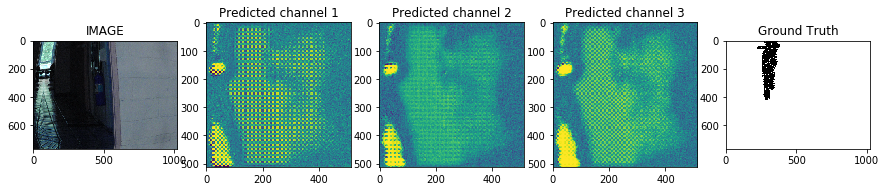

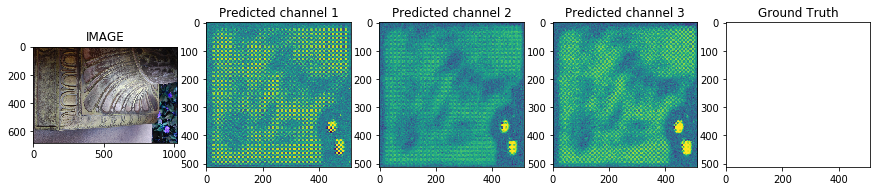

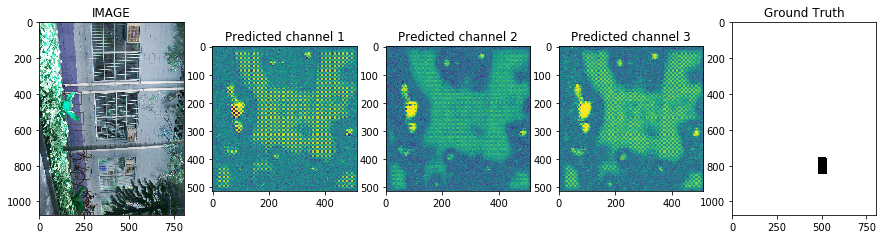

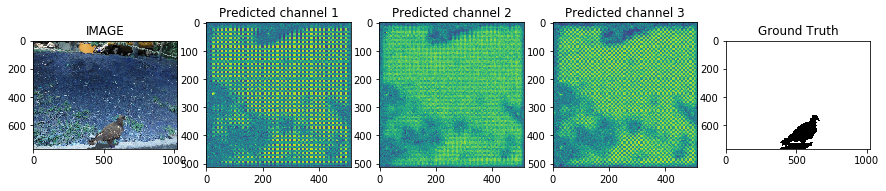

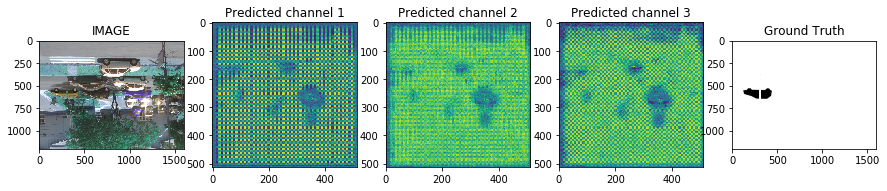

...

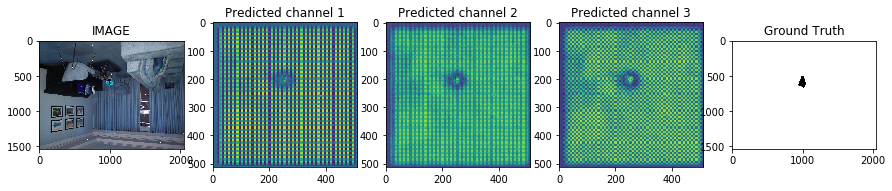

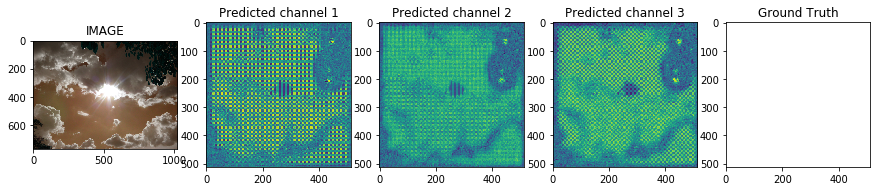

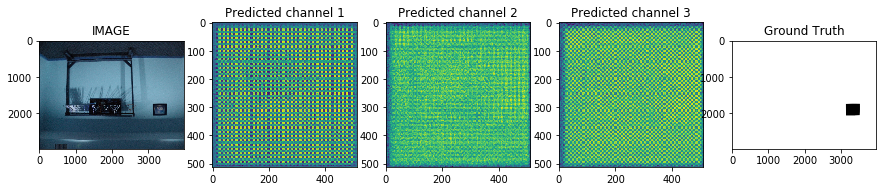

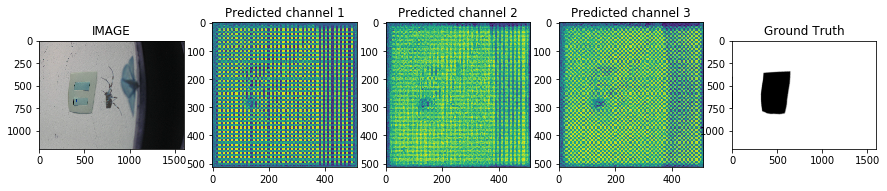

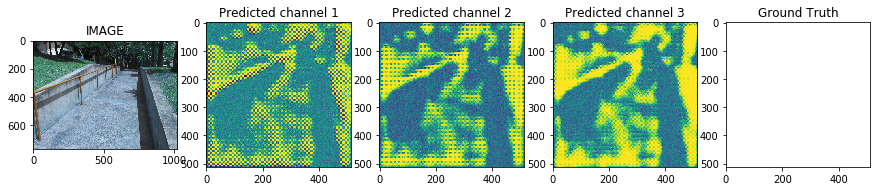

In [29]:
for i in np.arange(1,50):
    plot_comparision(i)

# SRM filter applied images

In [138]:
import tensorflow as tf

q = [4.0, 12.0, 2.0]
filter1 = [[0, 0, 0, 0, 0],
                   [0, -1, 2, -1, 0],
                   [0, 2, -4, 2, 0],
                   [0, -1, 2, -1, 0],
                   [0, 0, 0, 0, 0]]
filter2 = [[-1, 2, -2, 2, -1],
                   [2, -6, 8, -6, 2],
                   [-2, 8, -12, 8, -2],
                   [2, -6, 8, -6, 2],
                   [-1, 2, -2, 2, -1]]
filter3 = [[0, 0, 0, 0, 0],
                   [0, 0, 0, 0, 0],
                   [0, 1, -2, 1, 0],
                   [0, 0, 0, 0, 0],
                   [0, 0, 0, 0, 0]]


filter1 = np.asarray(filter1, dtype=float) / q[0]
filter2 = np.asarray(filter2, dtype=float) / q[1]
filter3 = np.asarray(filter3, dtype=float) / q[2]
    
filters = filter1+filter2+filter3

In [147]:
fake_aug_path

'augmented_data/images/'

In [168]:
for x in fake_aug:
    image = imread(fake_aug_path+x)
    processed_image = cv2.filter2D(image,-1,filters)
    plt.imsave(x,processed_image)
    break

# Multi Input Unet Model

In [169]:
input_img = Input((512, 512, 3), name='img1')
n_filters=16
batchnorm=True
dropout=0.5
# contracting path
c1 = conv2d_block(input_img, n_filters=n_filters*1, kernel_size=3, batchnorm=batchnorm)
p1 = MaxPooling2D((2, 2)) (c1)
p1 = Dropout(dropout*0.5)(p1)
c2 = conv2d_block(p1, n_filters=n_filters*2, kernel_size=3, batchnorm=batchnorm)
p2 = MaxPooling2D((2, 2)) (c2)
p2 = Dropout(dropout)(p2)
c3 = conv2d_block(p2, n_filters=n_filters*4, kernel_size=3, batchnorm=batchnorm)
p3 = MaxPooling2D((2, 2)) (c3)
p3 = Dropout(dropout)(p3)
c4 = conv2d_block(p3, n_filters=n_filters*8, kernel_size=3, batchnorm=batchnorm)
p4 = MaxPooling2D(pool_size=(2, 2)) (c4)
p4 = Dropout(dropout)(p4)
c5 = conv2d_block(p4, n_filters=n_filters*16, kernel_size=3, batchnorm=batchnorm)
#Expanding path
u6 = Conv2DTranspose(n_filters*8, (3, 3), strides=(2, 2), padding='same') (c5)
#skip_connections
u6 = concatenate([u6, c4])
u6 = Dropout(dropout)(u6)
c6 = conv2d_block(u6, n_filters=n_filters*8, kernel_size=3, batchnorm=batchnorm)
u7 = Conv2DTranspose(n_filters*4, (3, 3), strides=(2, 2), padding='same') (c6)
u7 = concatenate([u7, c3])
u7 = Dropout(dropout)(u7)
c7 = conv2d_block(u7, n_filters=n_filters*4, kernel_size=3, batchnorm=batchnorm)
u8 = Conv2DTranspose(n_filters*2, (3, 3), strides=(2, 2), padding='same') (c7)
u8 = concatenate([u8, c2])
u8 = Dropout(dropout)(u8)
c8 = conv2d_block(u8, n_filters=n_filters*2, kernel_size=3, batchnorm=batchnorm)
u9 = Conv2DTranspose(n_filters*1, (3, 3), strides=(2, 2), padding='same') (c8)
u9 = concatenate([u9, c1], axis=3)
u9 = Dropout(dropout)(u9)
c9 = conv2d_block(u9, n_filters=n_filters*1, kernel_size=3, batchnorm=batchnorm)

output = Conv2D(3, (1, 1), activation='sigmoid') (c9)
#model1 = Model(inputs=[input_img], outputs=[outputs])


input_img_filter = Input((512, 512, 3), name='img2')
n_filters=16
batchnorm=True
dropout=0.5

# contracting path
c1 = conv2d_block(input_img_filter, n_filters=n_filters*1, kernel_size=3, batchnorm=batchnorm)
p1 = MaxPooling2D((2, 2)) (c1)
p1 = Dropout(dropout*0.5)(p1)
c2 = conv2d_block(p1, n_filters=n_filters*2, kernel_size=3, batchnorm=batchnorm)
p2 = MaxPooling2D((2, 2)) (c2)
p2 = Dropout(dropout)(p2)
c3 = conv2d_block(p2, n_filters=n_filters*4, kernel_size=3, batchnorm=batchnorm)
p3 = MaxPooling2D((2, 2)) (c3)
p3 = Dropout(dropout)(p3)
c4 = conv2d_block(p3, n_filters=n_filters*8, kernel_size=3, batchnorm=batchnorm)
p4 = MaxPooling2D(pool_size=(2, 2)) (c4)
p4 = Dropout(dropout)(p4)
c5 = conv2d_block(p4, n_filters=n_filters*16, kernel_size=3, batchnorm=batchnorm)
#Expanding path
u6 = Conv2DTranspose(n_filters*8, (3, 3), strides=(2, 2), padding='same') (c5)
#skip_connections
u6 = concatenate([u6, c4])
u6 = Dropout(dropout)(u6)
c6 = conv2d_block(u6, n_filters=n_filters*8, kernel_size=3, batchnorm=batchnorm)
u7 = Conv2DTranspose(n_filters*4, (3, 3), strides=(2, 2), padding='same') (c6)
u7 = concatenate([u7, c3])
u7 = Dropout(dropout)(u7)
c7 = conv2d_block(u7, n_filters=n_filters*4, kernel_size=3, batchnorm=batchnorm)
u8 = Conv2DTranspose(n_filters*2, (3, 3), strides=(2, 2), padding='same') (c7)
u8 = concatenate([u8, c2])
u8 = Dropout(dropout)(u8)
c8 = conv2d_block(u8, n_filters=n_filters*2, kernel_size=3, batchnorm=batchnorm)
u9 = Conv2DTranspose(n_filters*1, (3, 3), strides=(2, 2), padding='same') (c8)
u9 = concatenate([u9, c1], axis=3)
u9 = Dropout(dropout)(u9)
c9 = conv2d_block(u9, n_filters=n_filters*1, kernel_size=3, batchnorm=batchnorm)

output_filter = Conv2D(3, (1, 1), activation='sigmoid') (c9)

combined = concatenate([output, output_filter])
outputs = Conv2D(1, (1, 1), activation='sigmoid') (combined)

model = Model(inputs=[input_img,input_img_filter], outputs=[outputs])

In [170]:
model.compile(optimizer=Adam(lr = 1e-4), loss="binary_crossentropy", metrics=["accuracy"])
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
img1 (InputLayer)               (None, 512, 512, 3)  0                                            
__________________________________________________________________________________________________
img2 (InputLayer)               (None, 512, 512, 3)  0                                            
__________________________________________________________________________________________________
conv2d_191 (Conv2D)             (None, 512, 512, 16) 448         img1[0][0]                       
__________________________________________________________________________________________________
conv2d_210 (Conv2D)             (None, 512, 512, 16) 448         img2[0][0]                       
__________________________________________________________________________________________________
batch_norm

                                                                 activation_188[0][0]             
__________________________________________________________________________________________________
concatenate_45 (Concatenate)    (None, 64, 64, 256)  0           conv2d_transpose_45[0][0]        
                                                                 activation_206[0][0]             
__________________________________________________________________________________________________
dropout_85 (Dropout)            (None, 64, 64, 256)  0           concatenate_41[0][0]             
__________________________________________________________________________________________________
dropout_93 (Dropout)            (None, 64, 64, 256)  0           concatenate_45[0][0]             
__________________________________________________________________________________________________
conv2d_201 (Conv2D)             (None, 64, 64, 128)  295040      dropout_85[0][0]                 
__________

In [205]:
train_generator = train_generator()
train_generator_filter = train_generator_filter()
valid_generator = valid_generator()
valid_generator_filter = valid_generator_filter()

def doubleTrainGenerator(train_generator,train_generator_filter):

    while True:
        for (x1,y1),(x2,y2) in zip(train_generator,train_generator_filter):
            yield ([x1,x2],[y1])
            
def doubleValidGenerator(valid_generator,valid_generator_filter):

    while True:
        for (x1,y1),(x2,y2) in zip(valid_generator,valid_generator_filter):
            yield ([x1,x2],[y1])


# Fakes + SRM applied noise Input two stream output.

In [206]:
history = model.fit_generator(generator = doubleTrainGenerator(train_generator,train_generator_filter),
                    steps_per_epoch=16,
                    epochs=max_epochs,
                    verbose=2,
                    validation_data=doubleValidGenerator(valid_generator,valid_generator_filter),
                    validation_steps=16)

Epoch 1/10
 - 248s - loss: 0.3696 - acc: 0.0422 - val_loss: 0.9615 - val_acc: 0.1029
Epoch 2/10
 - 237s - loss: 0.3609 - acc: 0.0442 - val_loss: 1.0901 - val_acc: 0.0993
Epoch 3/10
 - 236s - loss: 0.3518 - acc: 0.0566 - val_loss: 1.2321 - val_acc: 0.0431
Epoch 4/10
 - 238s - loss: 0.3436 - acc: 0.0544 - val_loss: 1.2425 - val_acc: 0.0535
Epoch 5/10
 - 249s - loss: 0.3364 - acc: 0.0248 - val_loss: 1.2462 - val_acc: 0.0692
Epoch 6/10
 - 249s - loss: 0.3294 - acc: 0.0453 - val_loss: 1.3268 - val_acc: 0.0353
Epoch 7/10
 - 246s - loss: 0.3227 - acc: 0.0547 - val_loss: 1.3041 - val_acc: 0.0633
Epoch 8/10
 - 242s - loss: 0.3193 - acc: 0.0408 - val_loss: 1.3685 - val_acc: 0.0244
Epoch 9/10
 - 244s - loss: 0.3143 - acc: 0.0294 - val_loss: 1.3053 - val_acc: 0.0742
Epoch 10/10
 - 241s - loss: 0.3083 - acc: 0.0166 - val_loss: 1.3624 - val_acc: 0.0340


In [113]:
from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

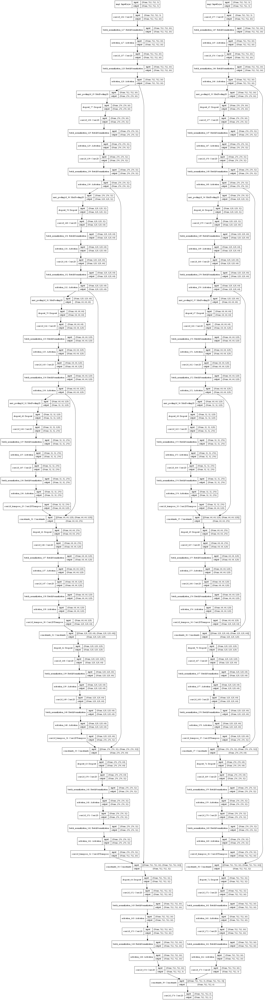

In [154]:
from IPython.display import Image
Image(retina=True, filename='model_plot.png')

In [207]:
test_generator = test_generator()
test_generator_filter = test_generator_filter()

def doubleTestGenerator(test_generator,test_generator_filter):

    while True:
        for (x1,y1),(x2,y2) in zip(test_generator,test_generator_filter):
            yield ([x1,x2])

In [208]:
predicted_test=model.predict_generator(generator=doubleTestGenerator(test_generator,test_generator_filter),steps=50)

In [209]:
model.save('model.h5')

In [27]:
def plot_comparision(image_id):
    fig, ax = plt.subplots(1, 5, figsize=(15, 10))
    ax[0].imshow(x_test_copy[image_id])
    ax[0].set_title('IMAGE')
    ax[1].imshow(predicted_test[image_id][:,:,0])
    ax[1].set_title('Predicted channel 1');
    ax[2].imshow(predicted_test[image_id][:,:,1])
    ax[2].set_title('Predicted channel 2');
    ax[3].imshow(predicted_test[image_id][:,:,2])
    ax[3].set_title('Predicted channel 3');
    ax[4].imshow(y_test_images[image_id],cmap='Greys_r')
    ax[4].set_title('Ground Truth');

C:\Users\U6069188\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


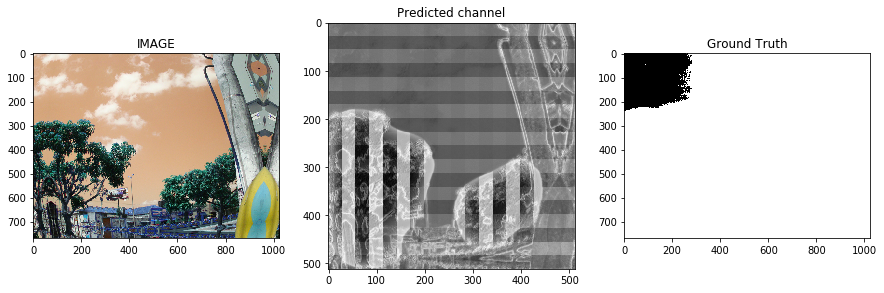

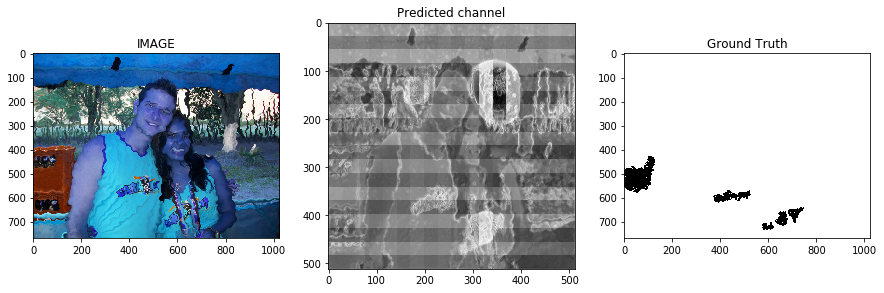

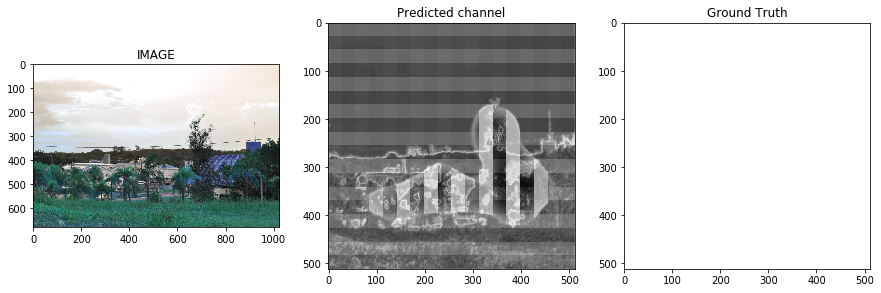

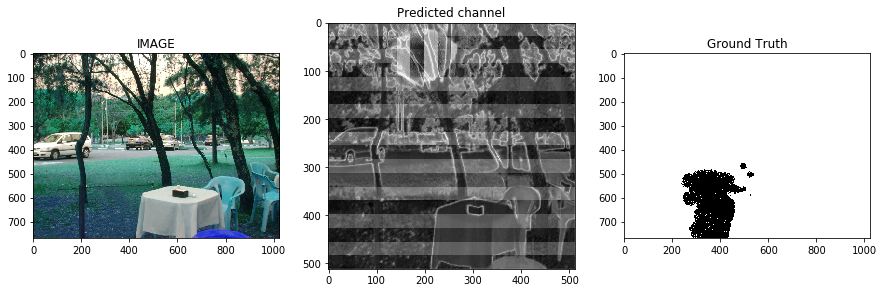

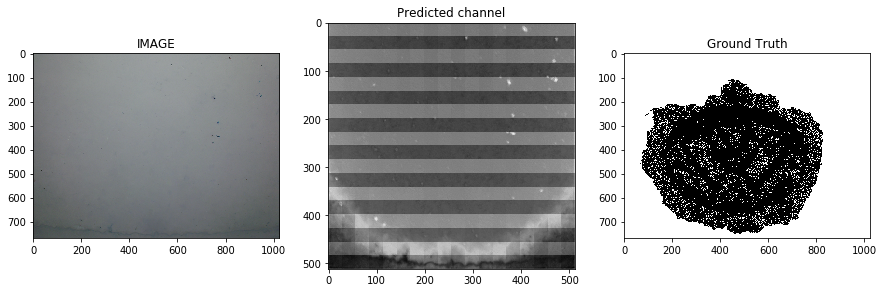

...

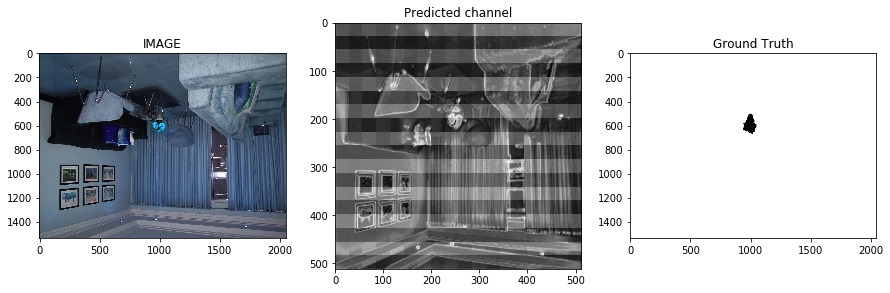

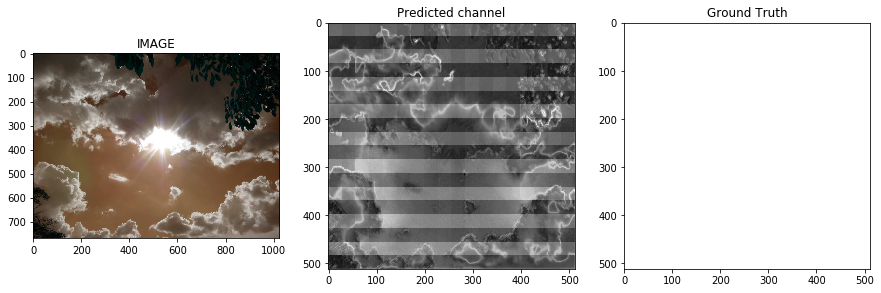

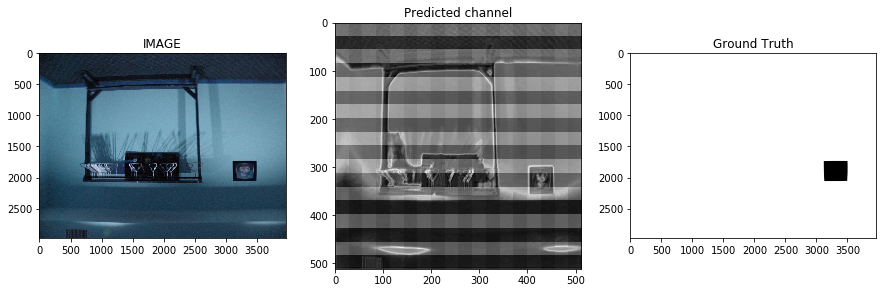

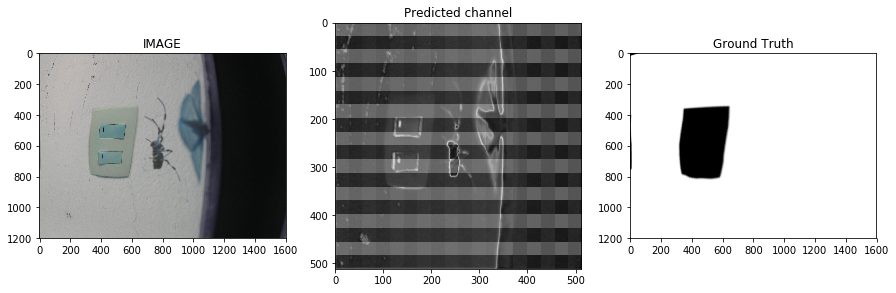

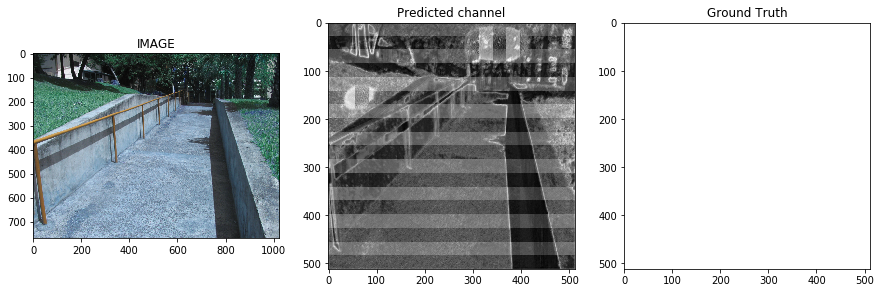

In [211]:
for i in np.arange(10,50):
    plot_comparision(i)

# Observations:

# Phase 1:
As seen the pristines,fakes,mask contain different channel images.We are only considereing channel 3 for pristines and fakes and we are converting the 4 channel images to 3 channeland 1 channels are discarded.Since all 3 channels of the mask contain the same information (fake part of an image in different pixels), we need only 1 channel to extract samples.

After all data cleaning we have :

1047 pristine images (3 channels)
450 fake images (3 channels)
450 masks (1 channel)

As part of feature engineering we have extracted image patches from training images both from pristine and fake images. 

We use the mask to sample the fake image along the boundary of the spliced region in such a way so as to ensure at least a 25% contribution from both forged part and unforged part of the image. These samples has the distinguishing boundaries that would be present only in fake images.

To make boundaries even more distinct, the grayscale images were converted to binary using Otsu’s thresholding after denoising using a Gaussian filter. After this operation, sampling was merely a matter of moving a 64×64 window (with a stride of 8) through the fake image and counting 0 valued (black) pixels in the corresponding mask and sampling in case the value lies in a certain interval.

Now we have a large dataset of good quality input images. We have tried fine tuning the last layer of VGG16 and ResNet50 + shallow model.

We have obtained decent accuracy for both the models with ResNet performing slighty better with 94.528% test accuracy.


# Phase2

ELA: An error level analysis method which aims to find the compression error difference between tampered
regions and authentic regions through different JPEG compression qualities. The same image is subjected to a uniform 90%-100% quality JPEG compression. We choosed JPEG compression quality value as 95% and applied it to all the images.

We hae tried out 3 models 

1. ELA+UNET
2. ELA + SRM Filter
3. Fakes+SRM Filter

Out of the above three we have used data augumentations for 1 and 2 unfortunatly they have not performed as expected. Model 3 Fake + SRM filter has done reasonably well.

There is a lot of scope to improve the performance by using data augumentations and also including the pristine images in train data set with default mask.